# Project 2
# Reading a data which include 48505 articles. Then finding the most similar documents using Locality Sensitive Hashing.

# This project is divided into steps that are as following:

## 1. Reading Json data
## 2. Shingling articles
## 3. Convert n-grams into binary vector representation for each document.
## 4. Hashing function that maps integers 0, 1, . . . , k − 1 to bucket numbers 0 through k − 1.
## 5. Computing minhash algorithm
## 6. Hashing signature bands into buckets.
## 7. Tuning parameters to make sure the threshold is appropriate


In [1]:
import pandas as pd
import numpy as np
import json
import nltk
import string
from nltk import ngrams
from nltk.tokenize import word_tokenize
import urllib.request

def read_data(url):
    with urllib.request.urlopen(url) as response:
        data = json.loads(response.read())
    return data

def shingling_data(url, n=2):
    articles_data = read_data(url)

    def process_text(text):
        translator = str.maketrans('', '', string.punctuation) 
        text = text.translate(translator)  
        text = text.lower() 
        return text

    shingled_data = []
    for article in articles_data:
        text = article['Content'] + ' ' + article['Title']
        text = process_text(text)
        words = word_tokenize(text)

        ngrams_list = list(ngrams(words, n)) 
        shingled_data.append(ngrams_list)
    return shingled_data

url = 'https://www.ux.uis.no/~vsetty/data/assignment2_aricles.json'
shingled_documents = shingling_data(url)

print(shingled_documents[0])
    


[('tikcro', 'enters'), ('enters', 'into'), ('into', 'research'), ('research', 'and'), ('and', 'license'), ('license', 'agreement'), ('agreement', 'with'), ('with', 'yeda'), ('yeda', 'news'), ('news', 'medical'), ('medical', 'wednesday'), ('wednesday', '31st'), ('31st', 'december'), ('december', '2014'), ('2014', 'tikcro'), ('tikcro', 'technologies'), ('technologies', 'ltd'), ('ltd', 'otc'), ('otc', 'pk'), ('pk', 'tikrf'), ('tikrf', 'today'), ('today', 'announced'), ('announced', 'that'), ('that', 'it'), ('it', 'has'), ('has', 'entered'), ('entered', 'into'), ('into', 'a'), ('a', 'research'), ('research', 'and'), ('and', 'license'), ('license', 'agreement'), ('agreement', 'with'), ('with', 'yeda'), ('yeda', 'research'), ('research', 'and'), ('and', 'development'), ('development', 'company'), ('company', 'ltd'), ('ltd', 'the'), ('the', 'technology'), ('technology', 'transfer'), ('transfer', 'arm'), ('arm', 'of'), ('of', 'the'), ('the', 'weizmann'), ('weizmann', 'institute'), ('institute'

In [2]:
from collections import Counter
# This function wont be used later, but it is a great way to visualize the most frequent n-grams and how many times they appear
def getFrequentNgrams(articles):
    all_ngrams = []
    for article in articles:
        all_ngrams.extend(article)
    
    ngram_counts = Counter(all_ngrams) # Counter is repsponsible for counting the frequency of each n-gram
    most_frequent_ngrams = ngram_counts.most_common() # find the most common n-grams by using the Counter class
    
    return most_frequent_ngrams
    
    # Select most frequent n-grams
# example of how to use the function
most_frequent_ngrams = getFrequentNgrams(shingled_documents)
print(most_frequent_ngrams[:10])

   

[(('of', 'the'), 131156), (('in', 'the'), 103720), (('’', 's'), 70368), (('to', 'the'), 58317), (('on', 'the'), 39414), (('for', 'the'), 37709), (('at', 'the'), 31172), (('and', 'the'), 30761), (('from', 'the'), 29519), (('to', 'be'), 28536)]


In [3]:
import heapq
# This function will be used to create the binary matrix, top_n is set at 4000 for faster computation, but should be higher (10000) for better results. 
def getBinaryMatrix(docs, top_n=4000):
    ngram_freq = {}
    for doc in docs:
        for ngram in doc:
            ngram_freq[ngram] = ngram_freq.get(ngram, 0) + 1 # Incrementing (+1) for each ngram.
    
    # Select the top n most frequent n-grams
    top_ngrams = heapq.nlargest(top_n, ngram_freq, key=ngram_freq.get)
    
    # Create a mapping from n-gram to column index in the binary matrix
    ngram_to_index = {ngram: i for i, ngram in enumerate(top_ngrams)} 
    

    binary_matrix = []
    for doc in docs:
        binary_vector = [0] * top_n # create a binary vector with all zeros
        for ngram in doc:
            if ngram in ngram_to_index:
                binary_vector[ngram_to_index[ngram]] = 1 # set the value to 1 if the ngram is in the top n
        binary_matrix.append(binary_vector)
    
    return binary_matrix



In [4]:
import random
def getHashFunctionValues(num_rows, num_hashfunctions): 

    hash_value_matrix = [] 

    for _ in range(num_hashfunctions): 
        hash_values_row = [] 
        random_int = random.getrandbits(32) # Generating a random 32-bit integer because it is most efficient for the hash function
        for j in range(num_rows): 
            hash_values_row.append((hash(j) ^ random_int)) 
        hash_value_matrix.append(hash_values_row) 
        
    return np.array(hash_value_matrix) # Convert to numpy, needed for later.

In [5]:
import numpy as np

def getMinHashSignatureMatrix(binary_matrix, hashvalue_matrix): 
    num_hashes, num_rows = hashvalue_matrix.shape # Get the number of hash functions and rows 
    num_cols = binary_matrix.shape[1]  # Get the number of columns

    # Following the pseudocode from the lecture, ask student assistant why we are using inf. 
    signature_matrix = np.full((num_hashes, num_cols), np.inf) 

    for col_index in range(num_cols):

        for hash_index in range(num_hashes):
            hash_values = hashvalue_matrix[hash_index]  

            if binary_matrix[:, col_index].any():
                # Getting 1's from the column
                nonzero_indices = np.nonzero(binary_matrix[:, col_index])[0]
                # Getting hash values for the 1's
                hash_values_for_column = hash_values[nonzero_indices % num_rows] 
                min_hash = np.min(hash_values_for_column)  # Get the minimum hash value
                signature_matrix[hash_index, col_index] = min_hash 

    return signature_matrix


In [6]:
def getLSH(signature_matrix, num_bands, num_buckets): 
    candidate_pairs = []

    # Mapping bands to buckets, trying to use differnt hashing way to check the performance
    hash_function = lambda band: sum(band) % num_buckets 

    band_size = len(signature_matrix) // num_bands
    bands = [signature_matrix[i:i + band_size] for i in range(0, len(signature_matrix), band_size)] # Split the signature matrix into bands

    for band in bands:
        bucket = hash_function(band) 
        if not any(bucket in cp for cp in candidate_pairs): # Check if the bucket is already in the list
            candidate_pairs.append(bucket) 
    return candidate_pairs    

In [7]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
# Mostly reusing probability/plot function from the lecture. 
def probability(s, r, b):
    # s: similarity
    # r: rows (per band)
    # b: number of bands
    return 1 - (1 - s**r)**b

results = pd.DataFrame({
    's': [],
    'P': [],
    'r,b': []
})

for s in np.arange(0.01, 1, 0.01):
    total = 100 
    for b in [100, 50, 25, 20, 10, 5, 4, 2, 1]: # b is the number of bands
        r = int(total/b) # r is the number of rows per band
        P = probability(s, r, b)
        results = results.append({
            's': s,
            'P': P,
            'r,b': f"{r},{b}"
        }, ignore_index=True)
        # s is the similarity threshold meaning the probability that two documents are similar

C:\Users\petni\AppData\Local\Temp\ipykernel_22172\2821424103.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results = results.append({
C:\Users\petni\AppData\Local\Temp\ipykernel_22172\2821424103.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results = results.append({
C:\Users\petni\AppData\Local\Temp\ipykernel_22172\2821424103.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results = results.append({
C:\Users\petni\AppData\Local\Temp\ipykernel_22172\2821424103.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results = results.append({
C:\Users\petni\AppData\Local\Temp\ipykernel_22172\2821424103.py:22: FutureWarnin

<Axes: xlabel='s', ylabel='P'>

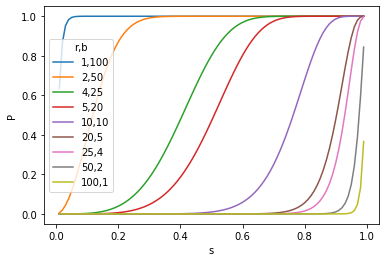

In [8]:
sns.lineplot(data=results, x='s', y='P', hue='r,b')


In [9]:

#url = 'https://www.ux.uis.no/~vsetty/data/assignment2_aricles.json'

# Parameters for hashing and LSH
#numrows = 100  # Number of rows for hash functions
numhashfunctions = 50  # Number of hash functions
num_bands = 20  # Number of bands for LSH
num_buckets = 10000  # Number of buckets for LSH


binary_matrix = np.array(getBinaryMatrix(shingled_documents))
# Step 3: Generate hash function values
hash_val_matrix = getHashFunctionValues(binary_matrix.shape[0], numhashfunctions)
hash_val_matrix

# bucket number affect the number of candidate pairs meaning that the number of bands and buckets affect the number of candidate pairs

array([[2497386497, 2497386496, 2497386499, ..., 2497422711, 2497422710,
        2497422713],
       [1072429206, 1072429207, 1072429204, ..., 1072383456, 1072383457,
        1072383470],
       [1157666776, 1157666777, 1157666778, ..., 1157638830, 1157638831,
        1157638816],
       ...,
       [2939548210, 2939548211, 2939548208, ..., 2939506500, 2939506501,
        2939506506],
       [3926531125, 3926531124, 3926531127, ..., 3926565187, 3926565186,
        3926565197],
       [1375469480, 1375469481, 1375469482, ..., 1375421150, 1375421151,
        1375421136]], dtype=int64)

In [10]:
# Step 4: Generate minhash signature matrix
numpy_hash_val_matrix = np.array(hash_val_matrix) # Has to be numpy or else list error will occur
numpy_binary_matrix = np.array(binary_matrix) # Has to be numpy or else list error will occur
signature = getMinHashSignatureMatrix(numpy_binary_matrix, numpy_hash_val_matrix)


In [11]:
# Step 5: Perform Locality Sensitive Hashing (LSH)
LSH = getLSH(signature, num_bands, num_buckets)
LSH

[array([2304., 2304., 2305., ..., 2759., 3387., 2467.]),
 array([8658., 8659., 8662., ..., 9116., 8777., 8785.]),
 array([818., 819., 826., ..., 936., 978., 903.]),
 array([3680., 3681., 3683., ..., 3719., 3737., 3984.]),
 array([3968., 3969., 3970., ..., 4271., 4090., 4177.]),
 array([5808., 5808., 5811., ..., 5949., 6220., 6300.]),
 array([2704., 2704., 2711., ..., 2724., 2829., 2782.]),
 array([7712., 7712., 7714., ..., 7922., 7868., 7866.]),
 array([9633., 9633., 9635., ...,  225., 9836., 9788.]),
 array([4960., 4960., 4966., ..., 5049., 5268., 5036.])]

In [12]:
def getJaccardSimilarityScore(C1, C2): #C1 and C2 are the candidate pairs
    intersection = len(set(C1).intersection(C2)) 
    union = len(set(C1).union(C2)) 
    return intersection / union 

In [16]:
nearest_neighbors = {}
for ids in LSH:
    for article_id in ids:
        if article_id not in nearest_neighbors:
            nearest_neighbors[article_id] = set() # Create a new set for the article
        nearest_neighbors[article_id].update([i for i in ids if i != article_id]) # Update the set with the other ids in the same bucket

print(nearest_neighbors)
nearest_neighbors


{2304.0: {2263.0, 2305.0, 2306.0, 2307.0, 2308.0, 2309.0, 2310.0, 2311.0, 2312.0, 2313.0, 2314.0, 2315.0, 2316.0, 2317.0, 2318.0, 2319.0, 2320.0, 2321.0, 2322.0, 2323.0, 2324.0, 2325.0, 2326.0, 2327.0, 2328.0, 2329.0, 2330.0, 2331.0, 2332.0, 2333.0, 2334.0, 2335.0, 2336.0, 2337.0, 2338.0, 2339.0, 2340.0, 2341.0, 2342.0, 2343.0, 2344.0, 2345.0, 2346.0, 2347.0, 2348.0, 2349.0, 2350.0, 2351.0, 2352.0, 2353.0, 2354.0, 2355.0, 2356.0, 2357.0, 2358.0, 2359.0, 2360.0, 2361.0, 2362.0, 2363.0, 2364.0, 2365.0, 2366.0, 2367.0, 2368.0, 2369.0, 2370.0, 2371.0, 2372.0, 2373.0, 2374.0, 2375.0, 2376.0, 2377.0, 2378.0, 2379.0, 2380.0, 2381.0, 2382.0, 2383.0, 2384.0, 2385.0, 2386.0, 2387.0, 2388.0, 2389.0, 2390.0, 2391.0, 2392.0, 2393.0, 2394.0, 2395.0, 2396.0, 2397.0, 2398.0, 2399.0, 2400.0, 2401.0, 2402.0, 2403.0, 2404.0, 2405.0, 2406.0, 2407.0, 2408.0, 2409.0, 2410.0, 2411.0, 2412.0, 2413.0, 2414.0, 2415.0, 2416.0, 2417.0, 2418.0, 2419.0, 2420.0, 2421.0, 2422.0, 2423.0, 2424.0, 2425.0, 2426.0, 2427.0

{2304.0: {2263.0,
  2305.0,
  2306.0,
  2307.0,
  2308.0,
  2309.0,
  2310.0,
  2311.0,
  2312.0,
  2313.0,
  2314.0,
  2315.0,
  2316.0,
  2317.0,
  2318.0,
  2319.0,
  2320.0,
  2321.0,
  2322.0,
  2323.0,
  2324.0,
  2325.0,
  2326.0,
  2327.0,
  2328.0,
  2329.0,
  2330.0,
  2331.0,
  2332.0,
  2333.0,
  2334.0,
  2335.0,
  2336.0,
  2337.0,
  2338.0,
  2339.0,
  2340.0,
  2341.0,
  2342.0,
  2343.0,
  2344.0,
  2345.0,
  2346.0,
  2347.0,
  2348.0,
  2349.0,
  2350.0,
  2351.0,
  2352.0,
  2353.0,
  2354.0,
  2355.0,
  2356.0,
  2357.0,
  2358.0,
  2359.0,
  2360.0,
  2361.0,
  2362.0,
  2363.0,
  2364.0,
  2365.0,
  2366.0,
  2367.0,
  2368.0,
  2369.0,
  2370.0,
  2371.0,
  2372.0,
  2373.0,
  2374.0,
  2375.0,
  2376.0,
  2377.0,
  2378.0,
  2379.0,
  2380.0,
  2381.0,
  2382.0,
  2383.0,
  2384.0,
  2385.0,
  2386.0,
  2387.0,
  2388.0,
  2389.0,
  2390.0,
  2391.0,
  2392.0,
  2393.0,
  2394.0,
  2395.0,
  2396.0,
  2397.0,
  2398.0,
  2399.0,
  2400.0,
  2401.0,
  2402.0,
  

In [17]:
import copy

# # Remove the neighbors in same buckets but have similarity score < threshold s
# Reusing most of the code already provided, added threshold value to remove the neighbors in the same bucket but have similarity score < threshold s
n_copy = copy.deepcopy(nearest_neighbors)
submission_id = []
submission_nid = []
for article_id, neighbor_ids in n_copy.items():
    for nid in neighbor_ids:
        # Ensure that article_id and nid are integers
        article_id = int(article_id)
        nid = int(nid)
        
        # Check if the indices are within bounds
        if article_id < binary_matrix.shape[1] and nid < binary_matrix.shape[1]:
            score = getJaccardSimilarityScore(set(binary_matrix[:, article_id]), set(binary_matrix[:, nid]))
            # print(score)
            if score > 0.65:
                submission_id.append(article_id)
                submission_nid.append(nid)
            else:
               nearest_neighbors[article_id].remove(nid)


KeyboardInterrupt: 